# **Part I (A Neural Algorithm of Artistic Style):**

In [22]:
import tensorflow as tf
import numpy as np
import time
import functools
import IPython.display as display
from pathlib import Path
import random
from PIL import Image
from matplotlib import pyplot
import matplotlib.pyplot as plt
import matplotlib as mpl
import os

def load_img(path_to_img):
    max_dim = 512
    img = tf.io.read_file(path_to_img)
    img = tf.image.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)

    shape = tf.cast(tf.shape(img)[:-1], tf.float32)
    long_dim = max(shape)
    scale = max_dim / long_dim

    new_shape = tf.cast(shape * scale, tf.int32)

    img = tf.image.resize(img, new_shape)
    # in order to use CNN, add one additional dimension
    # to the original image
    # img shape: [height, width, channel] -> [batch_size, height, width, channel]
    img = img[tf.newaxis, :]

    return img

def imshow(image, title=None):
    if len(image.shape) > 3:
        image = tf.squeeze(image, axis=0)

    plt.imshow(image)
    if title:
        plt.title(title)

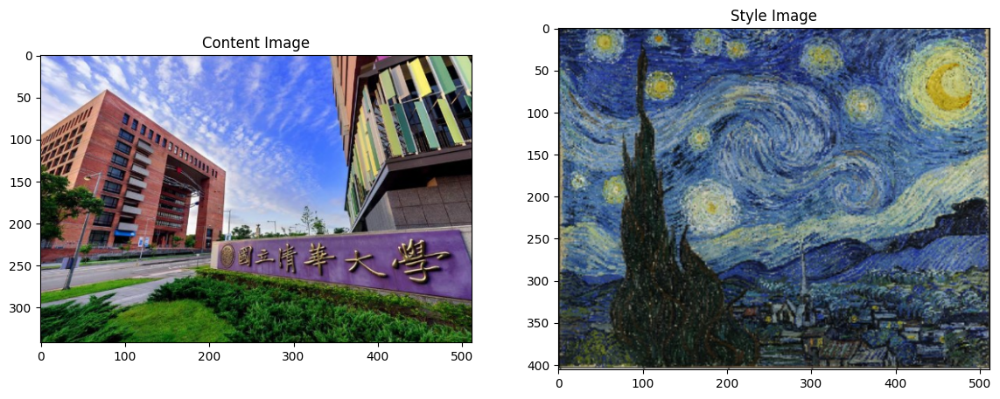

In [23]:
content_path = './content_nthu.jpg'
style_path = './style_starry_night.jpg'

content_image = load_img(content_path)
style_image = load_img(style_path)

plt.figure(figsize=(14,10))
plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image, 'Style Image')

In [24]:
vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')

print()
for layer in vgg.layers:
    print(layer.name)


input_layer_4
block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_conv4
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_conv4
block4_pool
block5_conv1
block5_conv2
block5_conv3
block5_conv4
block5_pool


In [116]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv2']

# Style layer of interest
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1',
                'block4_conv1',
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

In [117]:
def vgg_layers(layer_names):
    """ Creates a vgg model that returns a list of intermediate output values."""
    # Load our model. Load pretrained VGG, trained on imagenet data
    vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
    vgg.trainable = False

    outputs = [vgg.get_layer(name).output for name in layer_names]

    model = tf.keras.Model([vgg.input], outputs)
    return model

In [118]:
style_extractor = vgg_layers(style_layers)
style_outputs = style_extractor(style_image*255)

#Look at the statistics of each layer's output
for name, output in zip(style_layers, style_outputs):
    print(name)
    print("  shape: ", output.numpy().shape)
    print("  min: ", output.numpy().min())
    print("  max: ", output.numpy().max())
    print("  mean: ", output.numpy().mean())
    print()

block1_conv1
  shape:  (1, 406, 512, 64)
  min:  0.0
  max:  697.8643
  mean:  21.945343

block2_conv1
  shape:  (1, 203, 256, 128)
  min:  0.0
  max:  3143.2593
  mean:  133.0634

block3_conv1
  shape:  (1, 101, 128, 256)
  min:  0.0
  max:  6710.12
  mean:  120.735664

block4_conv1
  shape:  (1, 50, 64, 512)
  min:  0.0
  max:  13084.632
  mean:  461.96936

block5_conv1
  shape:  (1, 25, 32, 512)
  min:  0.0
  max:  2931.8281
  mean:  35.95835



In [119]:
def gram_matrix(input_tensor):
    result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
    input_shape = tf.shape(input_tensor)
    num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
    return result/(num_locations)

In [120]:
class StyleContentModel(tf.keras.models.Model):
    def __init__(self, style_layers, content_layers):
        super(StyleContentModel, self).__init__()
        self.vgg =  vgg_layers(style_layers + content_layers)
        self.style_layers = style_layers
        self.content_layers = content_layers
        self.num_style_layers = len(style_layers)
        self.vgg.trainable = False

    def call(self, inputs):
        "Expects float input in [0,1]"
        inputs = inputs*255.0
        preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
        outputs = self.vgg(preprocessed_input)
        style_outputs, content_outputs = (outputs[:self.num_style_layers],
                                          outputs[self.num_style_layers:])

        style_outputs = [gram_matrix(style_output)
                         for style_output in style_outputs]

        content_dict = {content_name:value
                        for content_name, value
                        in zip(self.content_layers, content_outputs)}

        style_dict = {style_name:value
                      for style_name, value
                      in zip(self.style_layers, style_outputs)}

        return {'content':content_dict, 'style':style_dict}

In [121]:
extractor = StyleContentModel(style_layers, content_layers)

results = extractor(tf.constant(content_image))

style_results = results['style']

print('Styles:')
for name, output in sorted(results['style'].items()):
    print("  ", name)
    print("    shape: ", output.numpy().shape)
    print("    min: ", output.numpy().min())
    print("    max: ", output.numpy().max())
    print("    mean: ", output.numpy().mean())
    print()

print("Contents:")
for name, output in sorted(results['content'].items()):
    print("  ", name)
    print("    shape: ", output.numpy().shape)
    print("    min: ", output.numpy().min())
    print("    max: ", output.numpy().max())
    print("    mean: ", output.numpy().mean())

Styles:
   block1_conv1
    shape:  (1, 64, 64)
    min:  0.07342515
    max:  19515.607
    mean:  864.73584

   block2_conv1
    shape:  (1, 128, 128)
    min:  0.0
    max:  142717.05
    mean:  24821.623

   block3_conv1
    shape:  (1, 256, 256)
    min:  2.7098947
    max:  1039886.7
    mean:  28506.996

   block4_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  7822918.0
    mean:  362456.72

   block5_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  156502.97
    mean:  2839.4307

Contents:
   block5_conv2
    shape:  (1, 21, 32, 512)
    min:  0.0
    max:  1521.5765
    mean:  19.424309


In [122]:
def style_content_loss(outputs):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2)
                           for name in style_outputs.keys()])
    style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2)
                             for name in content_outputs.keys()])
    content_loss *= content_weight / num_content_layers
    loss = style_loss + content_loss
    return style_loss, content_loss, loss

In [123]:
def clip_0_1(image):
    return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

In [126]:
@tf.function()
def train_step(image, step=1):
    with tf.GradientTape() as tape:
        outputs = extractor(image)
        style_loss, content_loss, loss = style_content_loss(outputs)
        #if step%100 == 0:
          #print("Step: ",step)
          #tf.print("Style loss: ",style_loss)
          #tf.print("Content loss: ",content_loss)

    # tape.gradient: d_loss/d_image
    grad = tape.gradient(loss, image)
    opt.apply_gradients([(grad, image)])
    image.assign(clip_0_1(image))

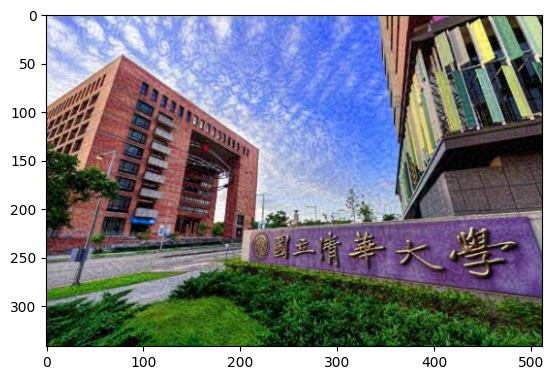

In [127]:
style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']

image = tf.Variable(content_image)
opt = tf.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)
style_weight = 1e-3   # Change it as you want
content_weight = 1e5  # Change it as you want

train_step(image)
train_step(image)
train_step(image)
plt.imshow(image.read_value()[0])

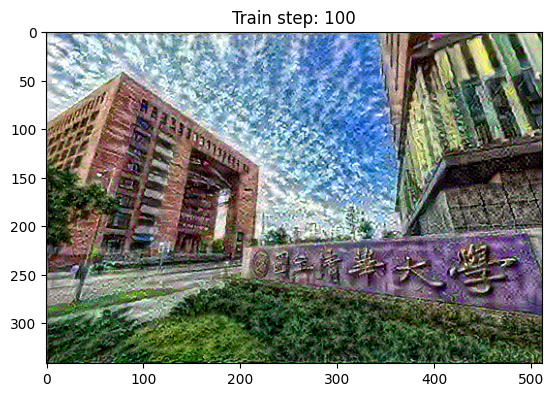

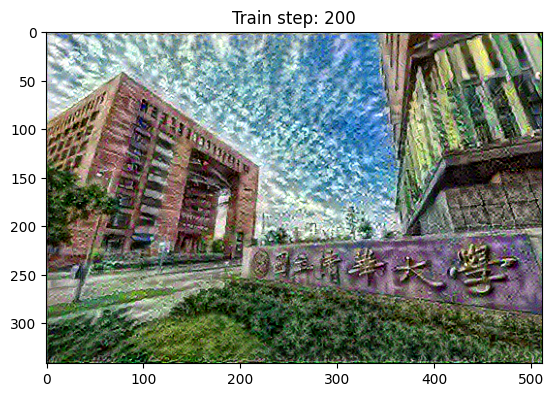

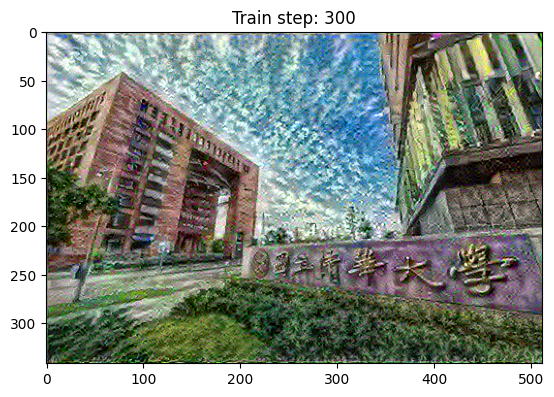

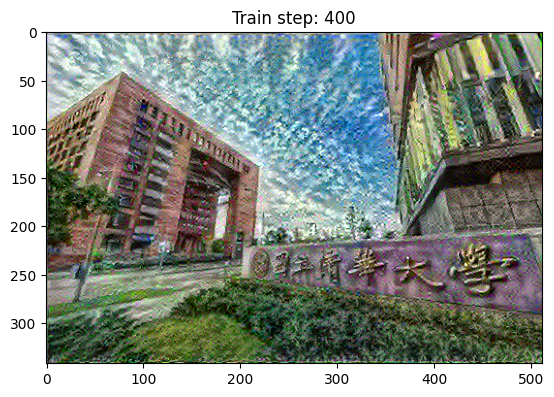

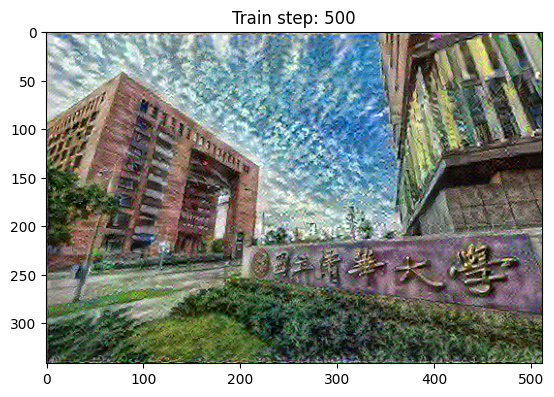

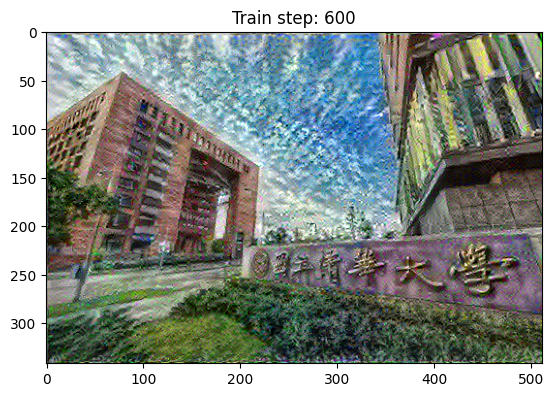

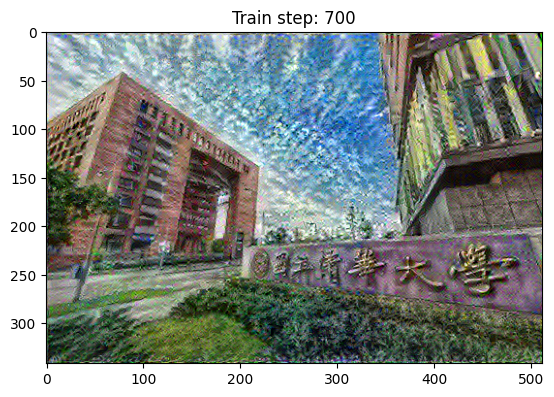

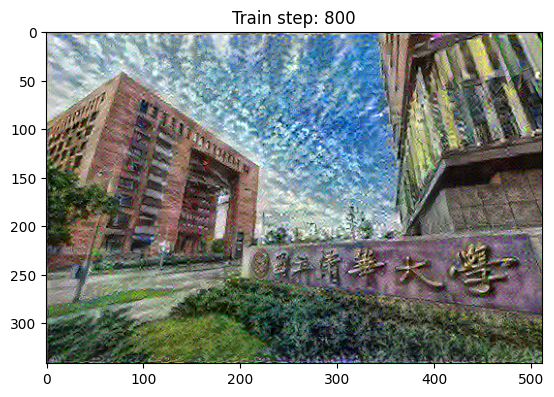

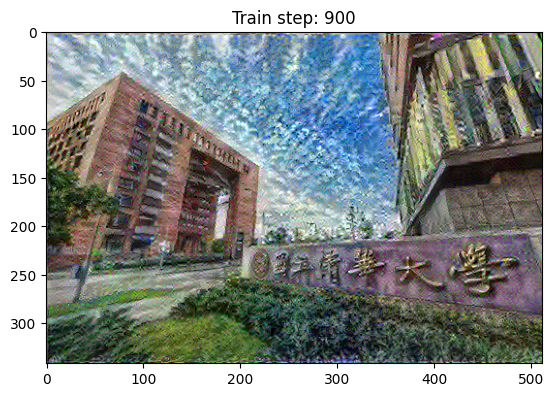

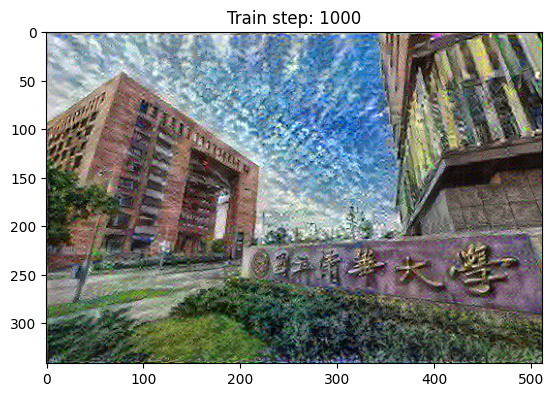

Total time: 637.4


In [128]:
import time
start = time.time()

epochs = 10
steps_per_epoch = 100

step = 0
for n in range(epochs):
    for m in range(steps_per_epoch):
        step += 1
        train_step(image, step)
    imshow(image.read_value())
    plt.title("Train step: {}".format(step))
    plt.show()


end = time.time()
print("Total time: {:.1f}".format(end-start))

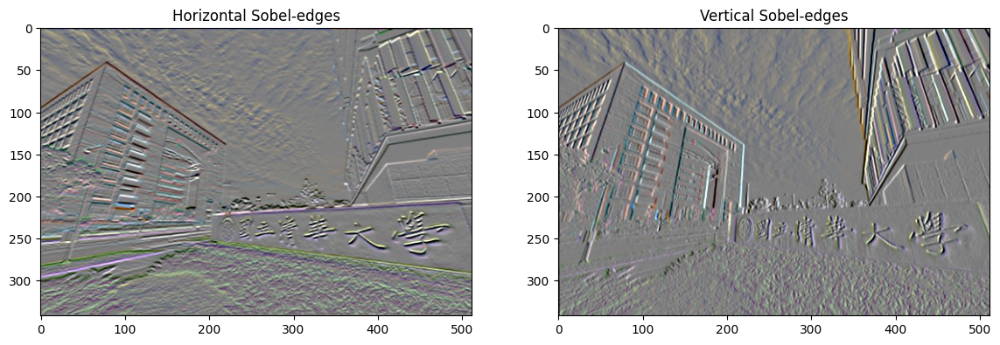

In [129]:
plt.figure(figsize=(14,10))

sobel = tf.image.sobel_edges(content_image)
plt.subplot(1,2,1)
imshow(clip_0_1(sobel[...,0]/4+0.5), "Horizontal Sobel-edges")
plt.subplot(1,2,2)
imshow(clip_0_1(sobel[...,1]/4+0.5), "Vertical Sobel-edges")

In [130]:
def total_variation_loss(image):
    # Calculate the difference between adjacent pixels in the image (i.e., TV loss)
    x_diff = image[:, :-1, :-1, :] - image[:, :-1, 1:, :]
    y_diff = image[:, :-1, :-1, :] - image[:, 1:, :-1, :]

    # Calculate the absolute value of the differences and sum them up to get the total variation loss
    loss = tf.reduce_sum(tf.abs(x_diff)) + tf.reduce_sum(tf.abs(y_diff))

    return loss

In [131]:
total_variation_weight = 100 # Change it as you want

In [132]:
opt = tf.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)

@tf.function()
def train_step(image):
    with tf.GradientTape() as tape:
        outputs = extractor(image)
        loss = style_content_loss(outputs)
        loss += total_variation_weight*total_variation_loss(image)

    grad = tape.gradient(loss, image)
    opt.apply_gradients([(grad, image)])
    image.assign(clip_0_1(image))

In [133]:
image = tf.Variable(content_image)

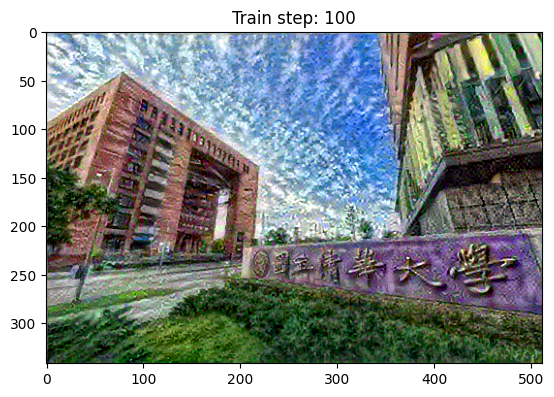

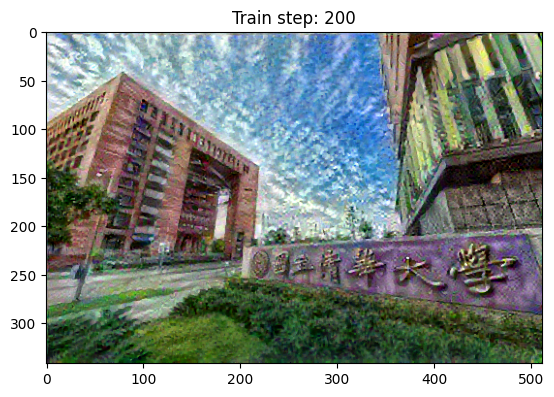

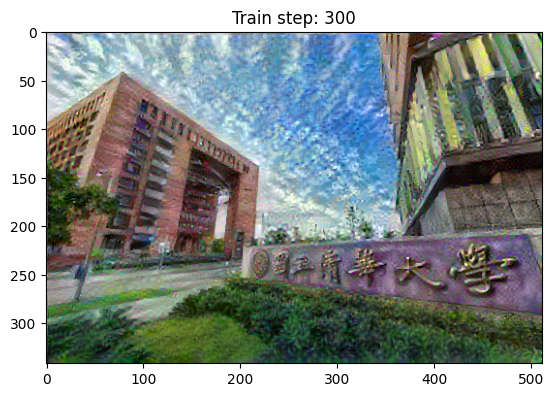

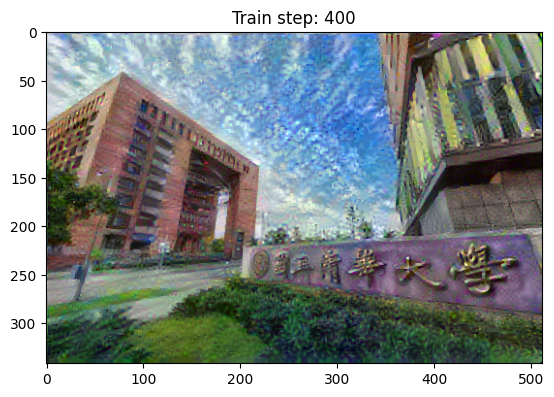

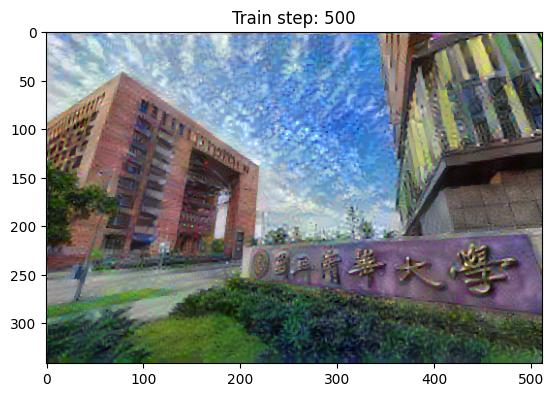

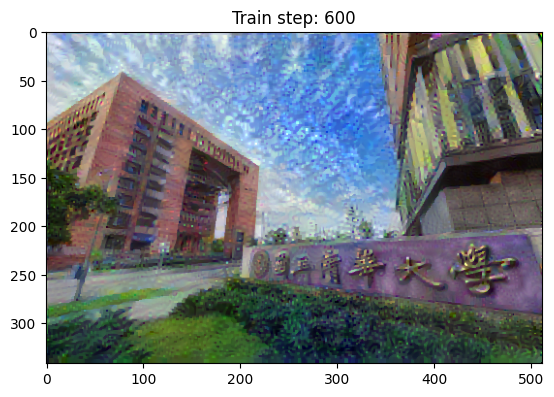

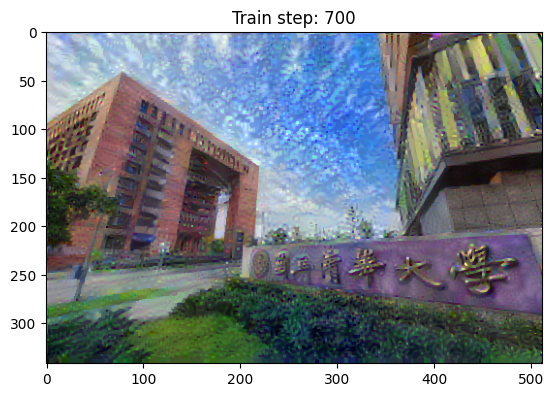

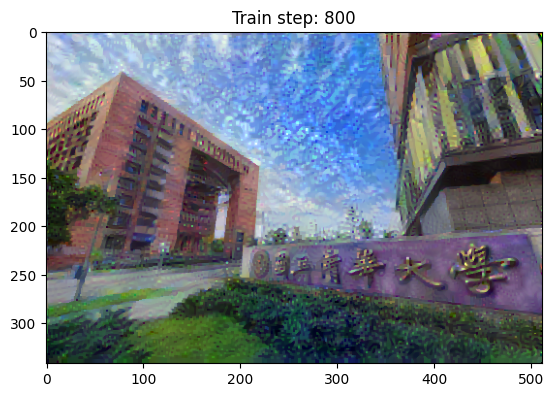

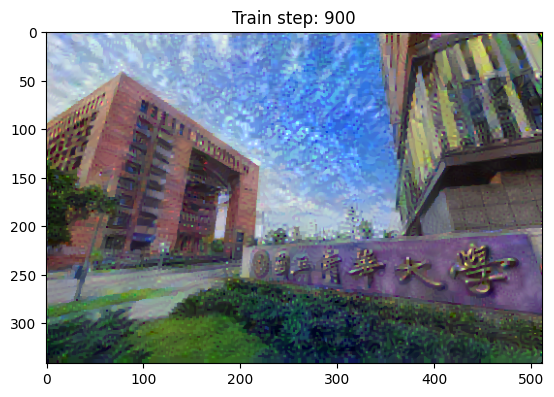

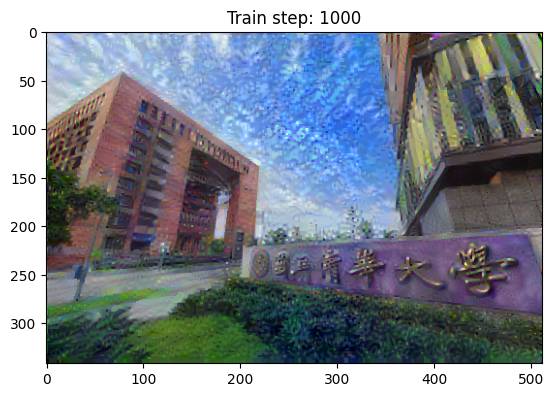

Total time: 74.5


In [134]:
start = time.time()

epochs = 10
steps_per_epoch = 100

step = 0
for n in range(epochs):
    for m in range(steps_per_epoch):
        step += 1
        train_step(image)
    imshow(image.read_value())
    plt.title("Train step: {}".format(step))
    plt.show()

end = time.time()
print("Total time: {:.1f}".format(end-start))

In [135]:
file_name = './Image2.png'
mpl.image.imsave(file_name, image[0].numpy())

# **Report:**
**Change the weights for the style, content, and total variational loss:**

Image1:Original layers,style_weight = 1,content_weight = 1e4,total_variation_weight = 100  
Image2:Original layers,style_weight = 1e-3,content_weight = 1e5,total_variation_weight = 100  
Image3:Original layers,style_weight = 1,content_weight = 1e4,total_variation_weight = 1

**Use other layers in the model:**

All style_weight = 1,content_weight = 1e4

Original layers:

Step:  1000 ; Style loss:  6710617.5 ; Content loss:  15927770

Change content layer to block1_conv2(Image4):

Step:  1000 ; Style loss:  14091853 ; Content loss:  50597216

**Discussion**

Impact of Weight Changes

Increasing Style Weight:

When the style weight is increased relative to the content weight, the generated image tends to exhibit more stylistic features, often leading to a more painterly effect. However, excessive emphasis on style can distort the original content, making it less recognizable.

Increasing Content Weight:

Conversely, increasing the content weight while decreasing the style weight can preserve the content features at the expense of stylistic fidelity. This leads to a generated image that closely resembles the content reference but lacks the distinct characteristics of the style.

Impact of Layer Selection
The choice of layers used to calculate the losses plays a crucial role in defining the characteristics of the output:

Higher Layers:

Layers closer to the output (higher layers) tend to capture more abstract and global features. Using these layers for style loss can result in a softer, less detailed stylistic effect.

Lower Layers:

Layers nearer to the input (lower layers) capture more local and detailed features. When these layers are used for style loss, the output retains more of the intricate patterns and textures of the style image.



# **Part II (AdaIN):**
Because gdown cannot be used due to traffic restrictions, and the original data set is too large to be downloaded and uploaded manually, I used a toy example to demonstrate. After all, this assignment is to implement AdaIN.

In [209]:
%matplotlib inline

CONTENT_DIRS = ['./dataset/content']
STYLE_DIRS = ['./dataset/style']

# VGG19 was trained by Caffe which converted images from RGB to BGR,
# then zero-centered each color channel with respect to the ImageNet
# dataset, without scaling.
IMG_MEANS = np.array([103.939, 116.779, 123.68]) # BGR

IMG_SHAPE = (224, 224, 3) # training image shape, (h, w, c)
SHUFFLE_BUFFER = 1000
BATCH_SIZE = 32
EPOCHS = 10
STEPS_PER_EPOCH = 12000 // BATCH_SIZE

Sampled content images:


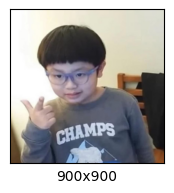

Sampled style images:


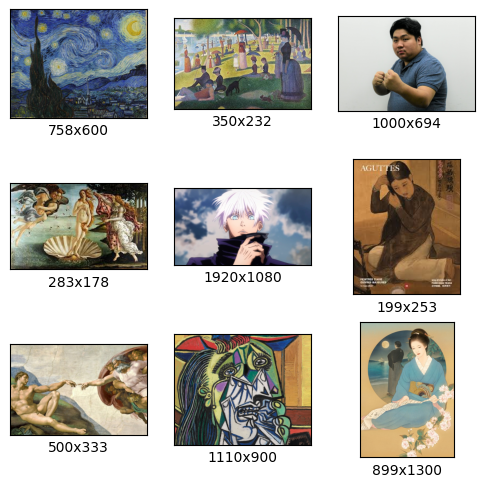

In [210]:
def sample_files(dir, num, pattern='**/*.jpg'):
    '''Samples files in a directory using the reservoir sampling.'''

    paths = Path(dir).glob(pattern) # list of Path objects
    sampled = []
    for i, path in enumerate(paths):
        if i < num:
            sampled.append(path)
        else:
            s = random.randint(0, i)
            if s < num:
                sampled[s] = path
    return sampled

def plot_images(dir, row, col, pattern):
    paths = sample_files(dir, row*col, pattern)

    plt.figure(figsize=(2*col, 2*row))
    for i in range(row*col):
        im = Image.open(paths[i])
        w, h = im.size

        plt.subplot(row, col, i+1)
        plt.imshow(im)
        plt.grid(False)
        plt.xticks([])
        plt.yticks([])
        plt.xlabel(f'{w}x{h}')
    plt.show()

print('Sampled content images:')
plot_images(CONTENT_DIRS[0], 1, 1, pattern='*.jpg')

print('Sampled style images:')
plot_images(STYLE_DIRS[0], 3, 3, pattern='*.jpg')

In [211]:
def clean(dir_path, min_shape=None):
    paths = Path(dir_path).glob('**/*.jpg')
    deleted  = 0
    for path in paths:
        try:
            # Make sure we can decode the image
            im = tf.io.read_file(str(path.resolve()))
            im = tf.image.decode_jpeg(im)

            # Remove grayscale images
            shape = im.shape
            if shape[2] < 3:
                path.unlink()
                deleted += 1

            # Remove small images
            if min_shape is not None:
                if shape[0] < min_shape[0] or shape[1] < min_shape[1]:
                    path.unlink()
                    deleted += 1
        except Exception as e:
            path.unlink()
            deleted += 1
    return deleted

for dir in CONTENT_DIRS:
    deleted = clean(dir)
print(f'#Deleted content images: {deleted}')

for dir in STYLE_DIRS:
    deleted = clean(dir)
print(f'#Deleted style images: {deleted}')

#Deleted content images: 0
#Deleted style images: 0


In [212]:
def preprocess_image(path, init_shape=(448, 448)):
    image = tf.io.read_file(path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, init_shape)
    image = tf.image.random_crop(image, size=IMG_SHAPE)
    image = tf.cast(image, tf.float32)

    # Convert image from RGB to BGR, then zero-center each color channel with
    # respect to the ImageNet dataset, without scaling.
    image = image[..., ::-1] # RGB to BGR
    image -= (103.939, 116.779, 123.68) # BGR means
    return image

def np_image(image):
    image += (103.939, 116.779, 123.68) # BGR means
    image = image[..., ::-1] # BGR to RGB
    image = tf.clip_by_value(image, 0, 255)
    image = tf.cast(image, dtype='uint8')
    return image.numpy()

def build_dataset(num_gpus=1):
    c_paths = []
    for c_dir in CONTENT_DIRS:
        c_paths += Path(c_dir).glob('*.jpg')
    c_paths = [str(path.resolve()) for path in c_paths]
    s_paths = []
    for s_dir in STYLE_DIRS:
        s_paths += Path(s_dir).glob('*.jpg')
    s_paths = [str(path.resolve()) for path in s_paths]
    print(f'Building dataset from {len(c_paths):,} content images and {len(s_paths):,} style images... ', end='')

    AUTOTUNE = tf.data.experimental.AUTOTUNE

    c_ds = tf.data.Dataset.from_tensor_slices(c_paths)
    c_ds = c_ds.map(preprocess_image, num_parallel_calls=AUTOTUNE)
    c_ds = c_ds.repeat()
    c_ds = c_ds.shuffle(buffer_size=SHUFFLE_BUFFER)

    s_ds = tf.data.Dataset.from_tensor_slices(s_paths)
    s_ds = s_ds.map(preprocess_image, num_parallel_calls=AUTOTUNE)
    s_ds = s_ds.repeat()
    s_ds = s_ds.shuffle(buffer_size=SHUFFLE_BUFFER)

    ds = tf.data.Dataset.zip((c_ds, s_ds))
    ds = ds.batch(BATCH_SIZE * num_gpus)
    ds = ds.prefetch(buffer_size=AUTOTUNE)

    print('done')
    return ds

Building dataset from 1 content images and 25 style images... done
Content batch shape: (32, 224, 224, 3)
Style batch shape: (32, 224, 224, 3)


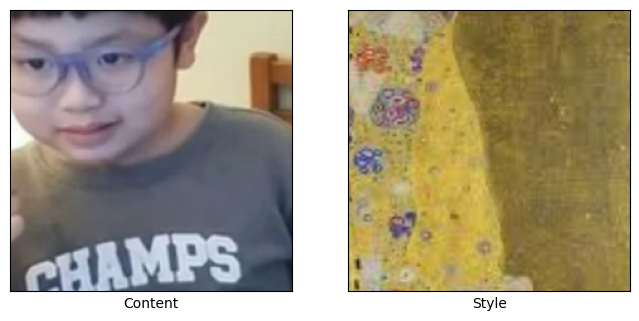

In [213]:
ds = build_dataset()
c_batch, s_batch = next(iter(ds.take(1)))

print('Content batch shape:', c_batch.shape)
print('Style batch shape:', s_batch.shape)

plt.figure(figsize=(8, 4))

plt.subplot(1, 2, 1)
plt.imshow(np_image(c_batch[0]))
plt.grid(False)
plt.xticks([])
plt.yticks([])
plt.xlabel('Content')

plt.subplot(1, 2, 2)
plt.imshow(np_image(s_batch[0]))
plt.grid(False)
plt.xticks([])
plt.yticks([])
plt.xlabel('Style')

plt.show()

In [230]:
class AdaIN(tf.keras.layers.Layer):
    def __init__(self, epsilon=1e-5, **kwargs):
        super(AdaIN, self).__init__(**kwargs)
        self.epsilon = epsilon  # Used to avoid division by zero

    def call(self, inputs):
        content, style = inputs

        # Calculate the mean and variance using tf.nn.moments
        content_mean, content_variance = tf.nn.moments(content, axes=[1, 2], keepdims=True)
        content_std = tf.sqrt(content_variance + self.epsilon)

        style_mean, style_variance = tf.nn.moments(style, axes=[1, 2], keepdims=True)
        style_std = tf.sqrt(style_variance + self.epsilon)

        # Adjust the content features
        normalized_content = style_std * (content - content_mean) / content_std + style_mean
        return normalized_content


In [215]:
class ArbitraryStyleTransferNet(tf.keras.Model):
    CONTENT_LAYER = 'block4_conv1'
    STYLE_LAYERS = ('block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1')

    @staticmethod
    def declare_decoder():
        a_input = tf.keras.Input(shape=(28, 28, 512), name='input_adain')

        h = tf.keras.layers.Conv2DTranspose(256, 3, padding='same', activation='relu')(a_input)
        h = tf.keras.layers.UpSampling2D(2)(h)
        h = tf.keras.layers.Conv2DTranspose(256, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.Conv2DTranspose(256, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.Conv2DTranspose(256, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.Conv2DTranspose(128, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.UpSampling2D(2)(h)
        h = tf.keras.layers.Conv2DTranspose(128, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.Conv2DTranspose(64, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.UpSampling2D(2)(h)
        h = tf.keras.layers.Conv2DTranspose(64, 3, padding='same', activation='relu')(h)
        output = tf.keras.layers.Conv2DTranspose(3, 3, padding='same')(h)

        return tf.keras.Model(inputs=a_input, outputs=output, name='decoder')

    def __init__(self,
                 img_shape=(224, 224, 3),
                 content_loss_weight=1,
                 style_loss_weight=10,
                 name='arbitrary_style_transfer_net',
                 **kwargs):
        super(ArbitraryStyleTransferNet, self).__init__(name=name, **kwargs)

        self.img_shape = img_shape
        self.content_loss_weight = content_loss_weight
        self.style_loss_weight = style_loss_weight

        vgg19 = tf.keras.applications.VGG19(include_top=False, weights='imagenet', input_shape=img_shape)
        vgg19.trainable = False

        c_output = [vgg19.get_layer(ArbitraryStyleTransferNet.CONTENT_LAYER).output]
        s_outputs = [vgg19.get_layer(name).output for name in ArbitraryStyleTransferNet.STYLE_LAYERS]
        self.vgg19 = tf.keras.Model(inputs=vgg19.input, outputs=c_output+s_outputs, name='vgg19')
        self.vgg19.trainable = False

        self.adain = AdaIN(name='adain')
        self.decoder = ArbitraryStyleTransferNet.declare_decoder()

    def call(self, inputs):
        c_batch, s_batch = inputs

        c_enc = self.vgg19(c_batch)
        c_enc_c = c_enc[0]

        s_enc = self.vgg19(s_batch)
        s_enc_c = s_enc[0]
        s_enc_s = s_enc[1:]

        # normalized_c is the output of AdaIN layer
        normalized_c = self.adain((c_enc_c, s_enc_c))
        output = self.decoder(normalized_c)

        # Calculate loss
        out_enc = self.vgg19(output)
        out_enc_c = out_enc[0]
        out_enc_s = out_enc[1:]

        loss_c = tf.reduce_mean(tf.math.squared_difference(out_enc_c, normalized_c))
        self.add_loss(self.content_loss_weight * loss_c)

        loss_s = 0
        for o, s in zip(out_enc_s, s_enc_s):
            o_mean, o_var = tf.nn.moments(o, axes=(1,2), keepdims=True)
            o_std = tf.sqrt(o_var + self.adain.epsilon)

            s_mean, s_var = tf.nn.moments(s, axes=(1,2), keepdims=True)
            s_std = tf.sqrt(s_var + self.adain.epsilon)

            loss_mean = tf.reduce_mean(tf.math.squared_difference(o_mean, s_mean))
            loss_std = tf.reduce_mean(tf.math.squared_difference(o_std, s_std))

            loss_s += loss_mean + loss_std
        self.add_loss(self.style_loss_weight * loss_s)

        return output, c_enc_c, normalized_c, out_enc_c

In [216]:
# Plot results
def plot_outputs(outputs, captions=None, col=5):
    row = len(outputs)
    plt.figure(figsize=(3*col, 3*row))
    for i in range(col):
        for j in range(row):
            plt.subplot(row, col, j*col+i+1)
            plt.imshow(np_image(outputs[j][i,...,:3]))
            plt.grid(False)
            plt.xticks([])
            plt.yticks([])
            if captions is not None:
                plt.xlabel(captions[j])
    plt.show()

In [217]:
ds = build_dataset()
model = ArbitraryStyleTransferNet(img_shape=IMG_SHAPE)

c_batch, s_batch = next(iter(ds.take(1)))
print(f'Input shape: ({c_batch.shape}, {s_batch.shape})')
output, *_ = model((c_batch, s_batch))
print(f'Output shape: {output.shape}')
print(f'Init. content loss: {model.losses[0]:,.2f}, style loss: {model.losses[1]:,.2f}')

Building dataset from 1 content images and 25 style images... done
Input shape: ((32, 224, 224, 3), (32, 224, 224, 3))
Output shape: (32, 224, 224, 3)
Init. content loss: 3,229,346.50, style loss: 21,783,064.00


In [218]:
# Train the model
optimizer = tf.keras.optimizers.Adam(learning_rate=5e-4)
c_loss_metric, s_loss_metric = tf.keras.metrics.Mean(), tf.keras.metrics.Mean()

CKP_DIR = 'checkpoints'
init_epoch = 1

ckp = tf.train.latest_checkpoint(CKP_DIR)
if ckp:
    model.load_weights(ckp)
    init_epoch = int(ckp.split('_')[-1]) + 1
    print(f'Resume training from epoch {init_epoch-1}')

In [219]:
@tf.function
def train_step(inputs):
    with tf.GradientTape() as tape:
        model(inputs)
        c_loss, s_loss = model.losses
        loss = c_loss + s_loss
    grads = tape.gradient(loss, model.trainable_variables)
    optimizer.apply_gradients(zip(grads, model.trainable_variables))

    c_loss_metric(c_loss)
    s_loss_metric(s_loss)

In [220]:
def train(dataset, init_epoch):
    for epoch in range(init_epoch, EPOCHS+1):
        print(f'Epoch {epoch:>2}/{EPOCHS}')
        for step, inputs in enumerate(ds.take(STEPS_PER_EPOCH)):
            train_step(inputs)
            print(f'{step+1:>5}/{STEPS_PER_EPOCH} - loss: {c_loss_metric.result()+s_loss_metric.result():,.2f} - content loss: {c_loss_metric.result():,.2f} - style loss: {s_loss_metric.result():,.2f}', end='\r')

        print()
        model.save_weights(os.path.join(CKP_DIR, f'ckpt_{epoch}.weights.h5'))
        c_loss_metric.reset_state()
        s_loss_metric.reset_state()

        output, c_enc_c, normalized_c, out_enc_c = model((c_batch, s_batch))
        plot_outputs((s_batch, c_batch, output, c_enc_c, normalized_c, out_enc_c),
                     ('Style', 'Content', 'Trans', 'Content Enc', 'Normalized', 'Trans Enc'))

Epoch  1/10
  375/375 - loss: 3,198,013.00 - content loss: 826,302.31 - style loss: 2,371,710.75


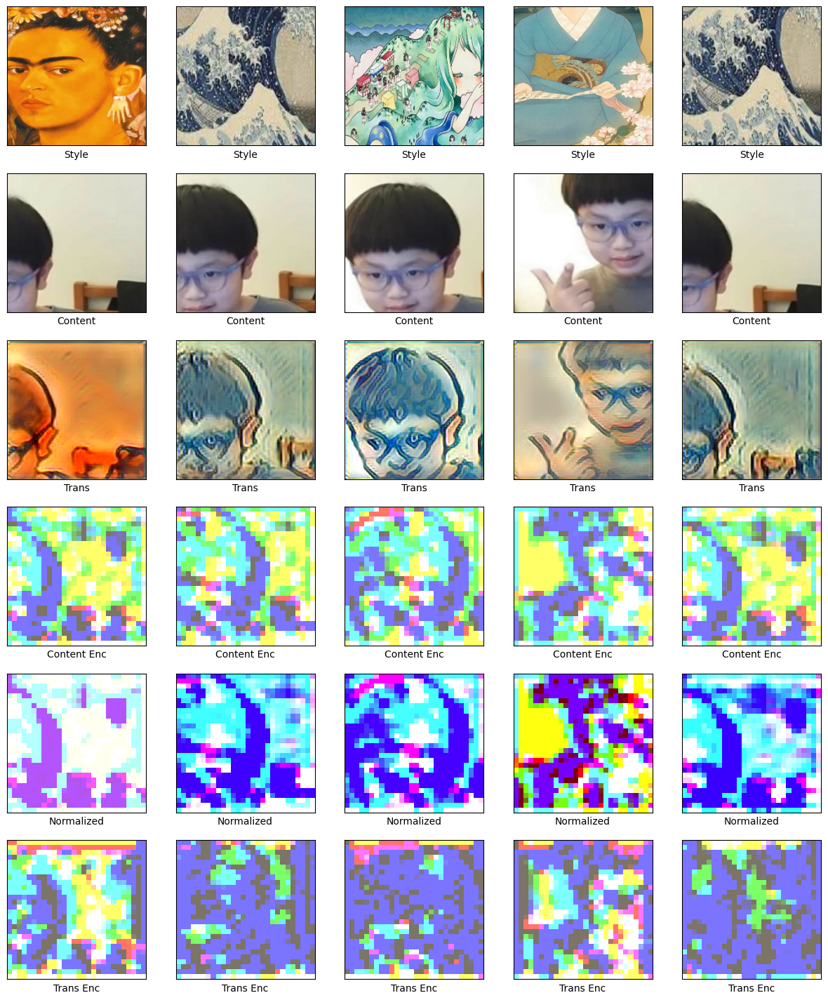

Epoch  2/10
  375/375 - loss: 945,361.31 - content loss: 497,048.75 - style loss: 448,312.56


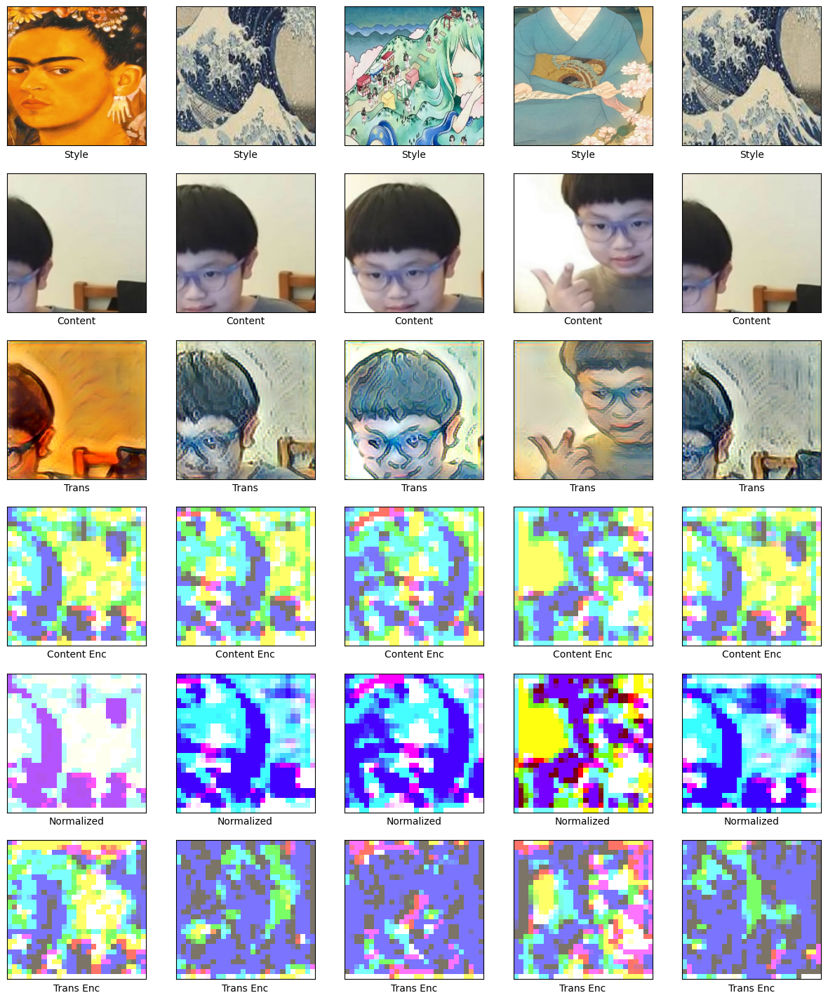

Epoch  3/10
  375/375 - loss: 757,570.62 - content loss: 415,722.72 - style loss: 341,847.91


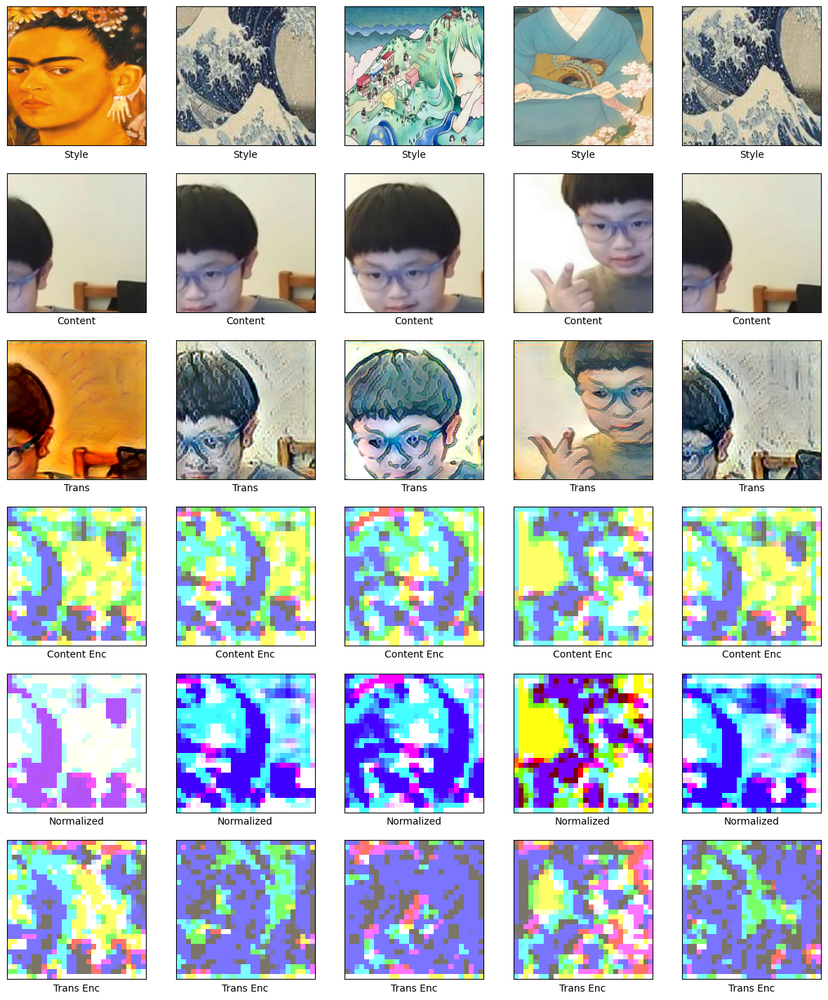

Epoch  4/10
  375/375 - loss: 649,655.38 - content loss: 367,799.94 - style loss: 281,855.47


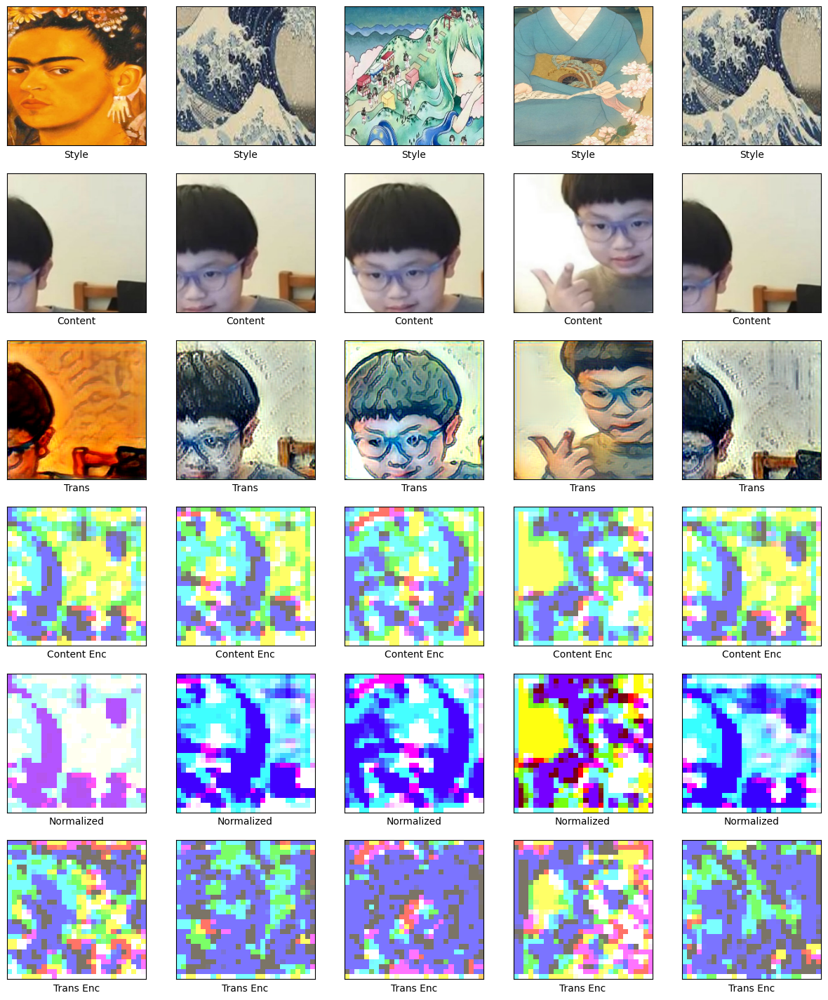

Epoch  5/10
  375/375 - loss: 612,387.44 - content loss: 345,972.75 - style loss: 266,414.69


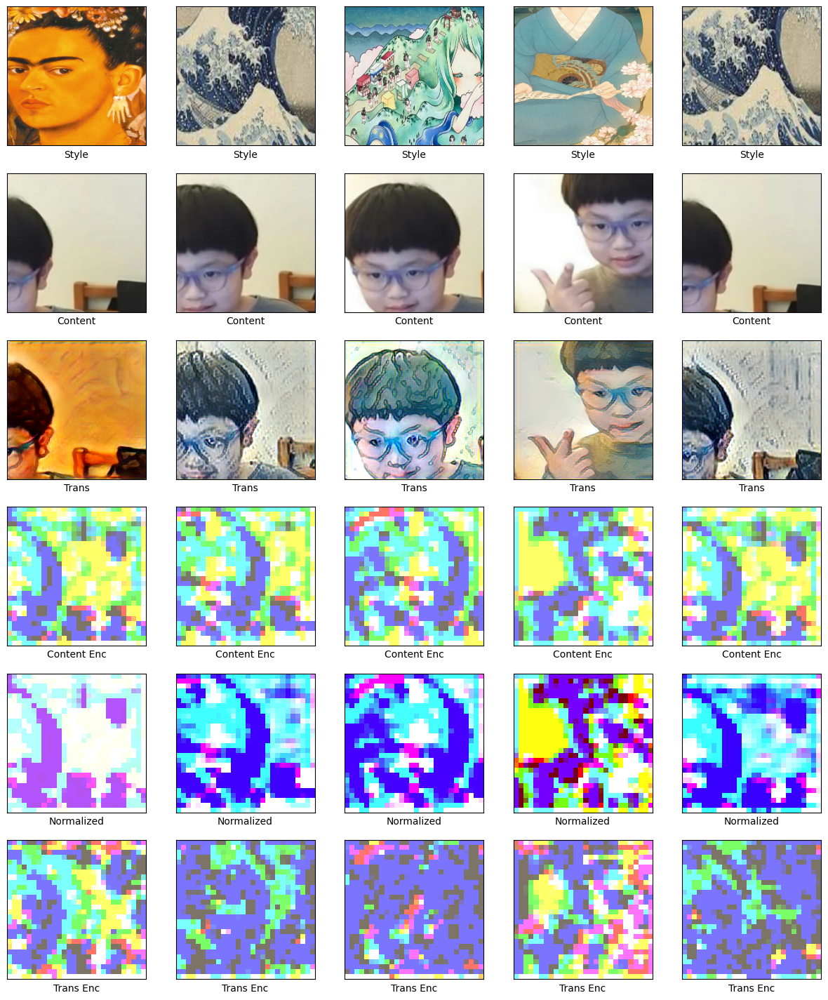

Epoch  6/10
  375/375 - loss: 561,586.62 - content loss: 322,607.91 - style loss: 238,978.70


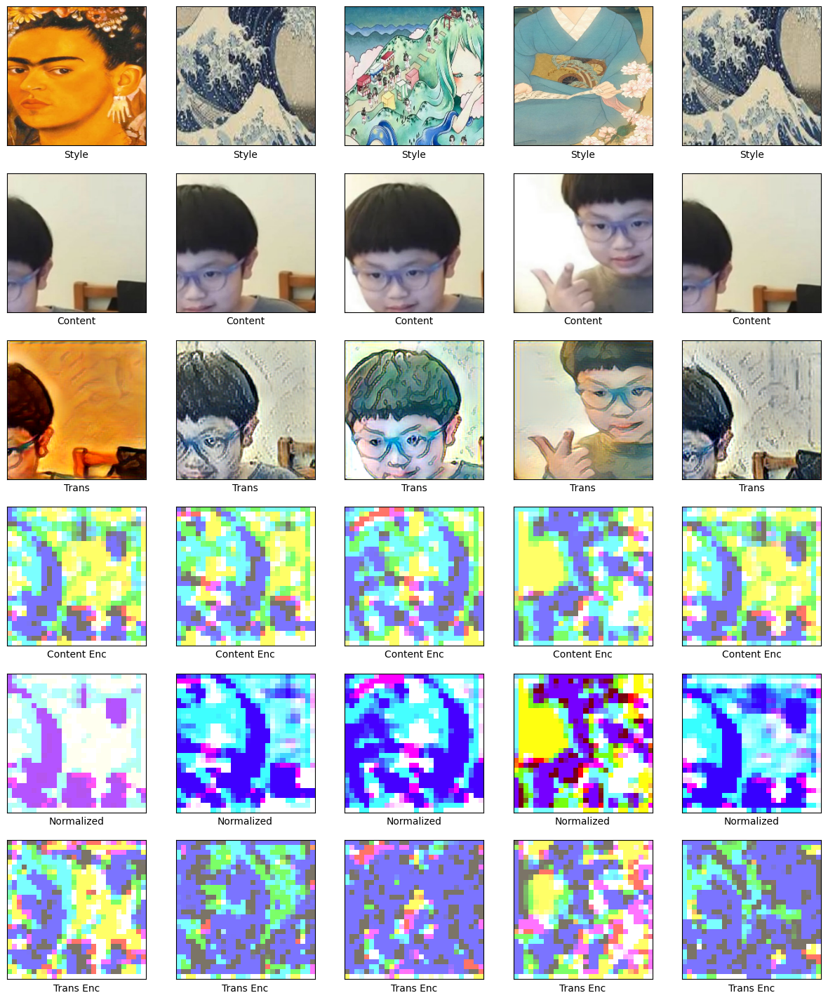

Epoch  7/10
  375/375 - loss: 535,243.56 - content loss: 308,227.03 - style loss: 227,016.52


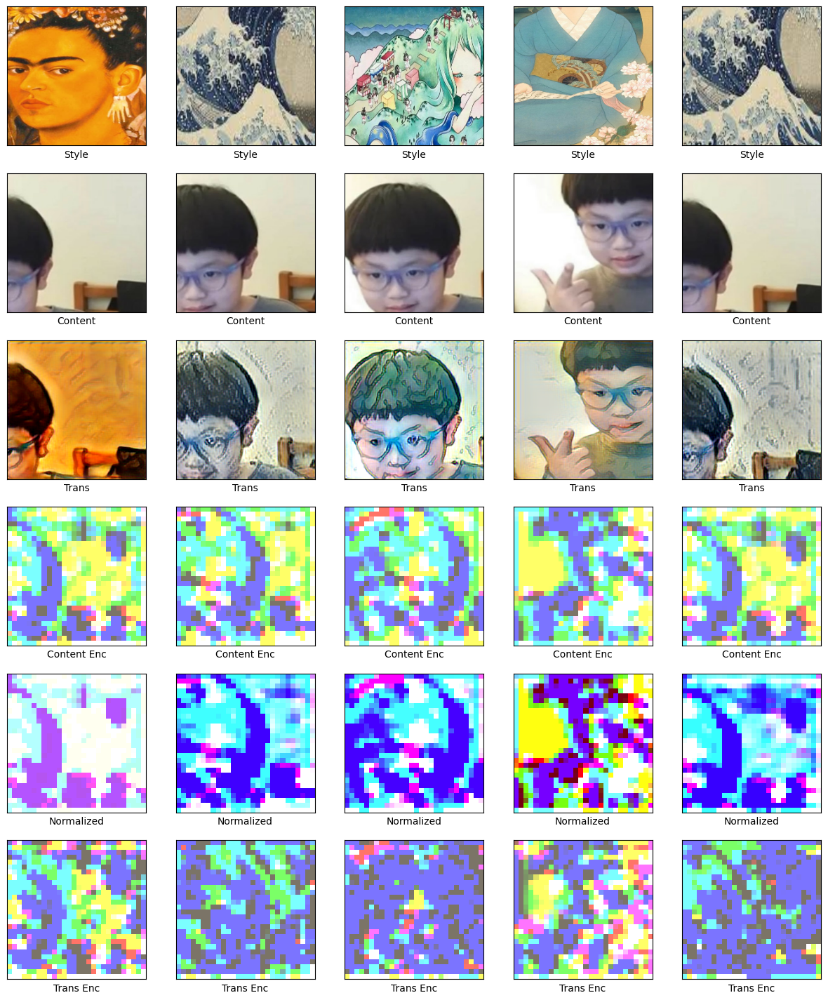

Epoch  8/10
  375/375 - loss: 524,179.69 - content loss: 299,215.03 - style loss: 224,964.66


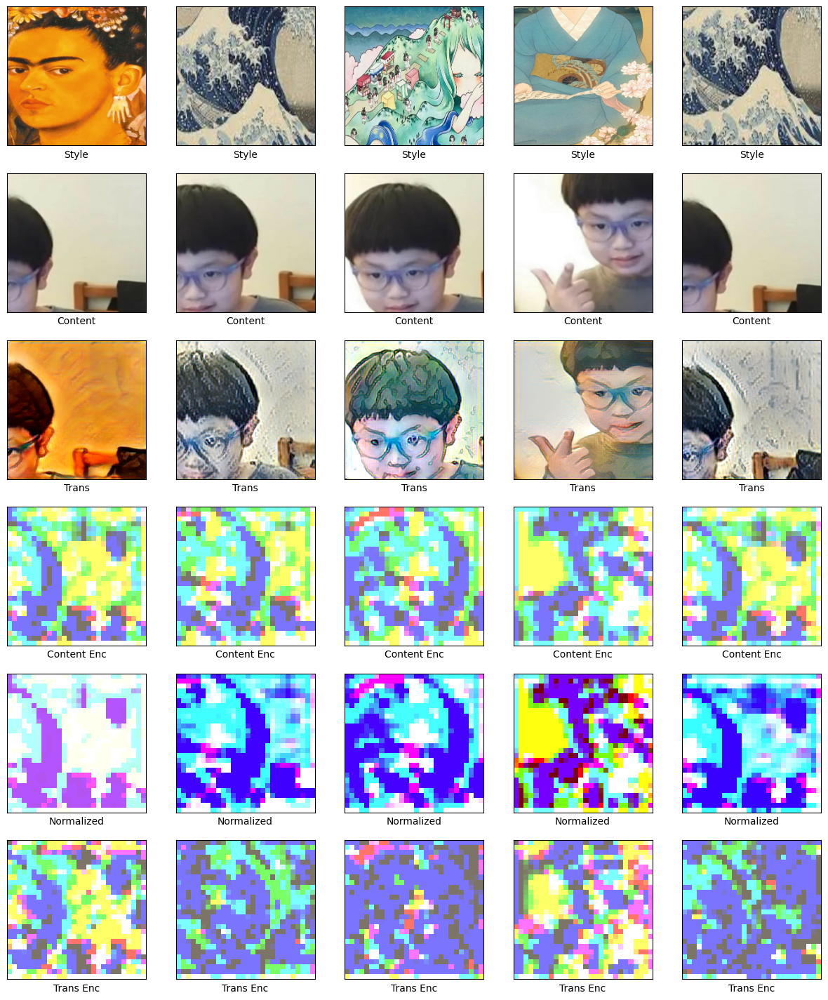

Epoch  9/10
  375/375 - loss: 507,582.81 - content loss: 290,617.59 - style loss: 216,965.23


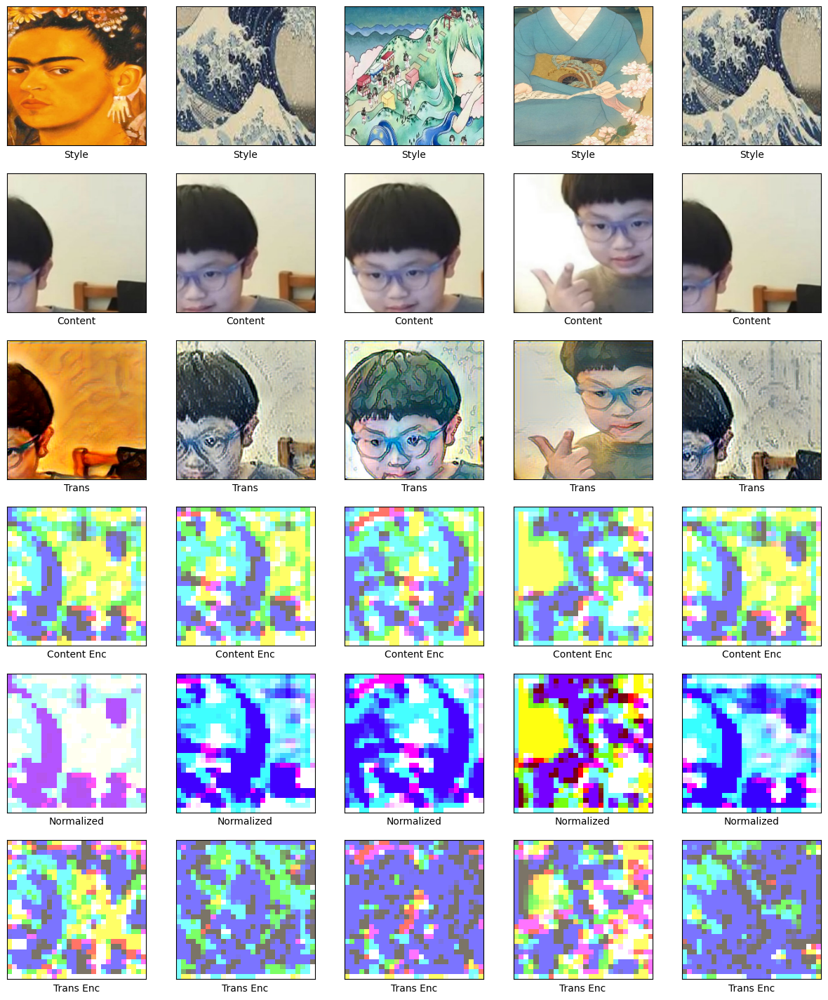

Epoch 10/10
  375/375 - loss: 484,786.62 - content loss: 282,378.06 - style loss: 202,408.58


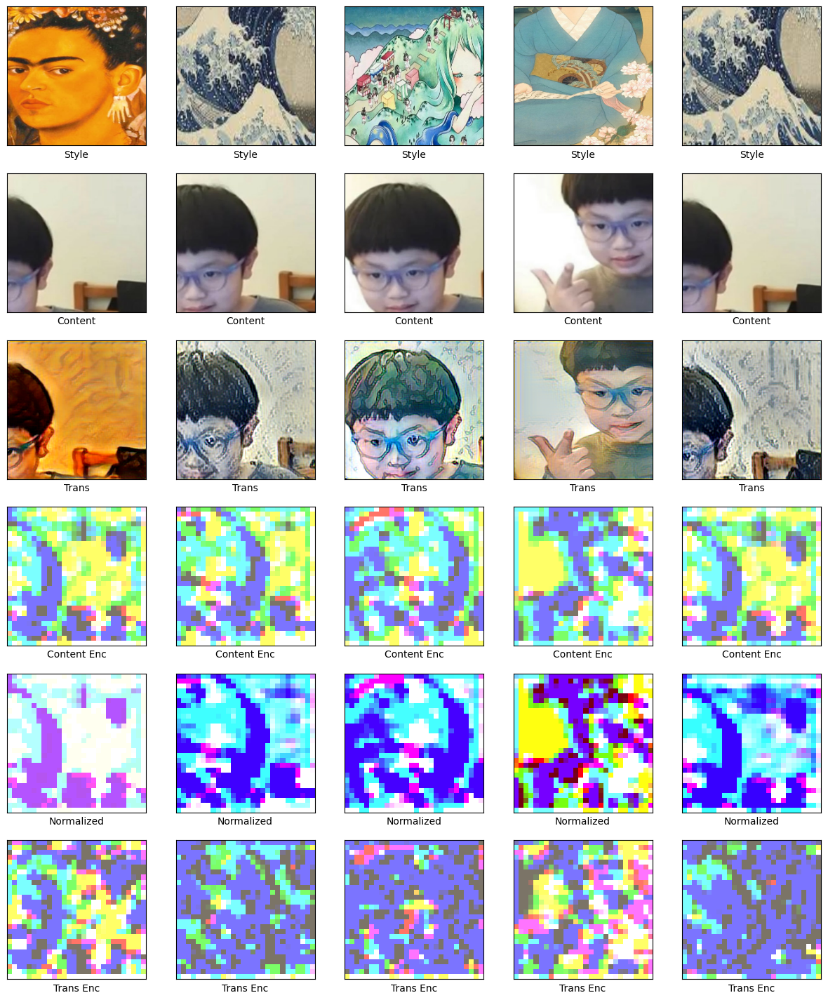

In [221]:
import os

os.makedirs('checkpoints', exist_ok=True)
train(ds, init_epoch)

In [223]:
def preprocess_example(path, init_shape=(IMG_SHAPE[0], IMG_SHAPE[1])):
    image = tf.io.read_file(path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, init_shape)
    image = tf.cast(image, tf.float32)

    # Convert image from RGB to BGR, then zero-center each color channel with
    # respect to the ImageNet dataset, without scaling.
    image = image[..., ::-1] # RGB to BGR
    image -= (103.939, 116.779, 123.68) # BGR means
    return image

def roger_example(num_gpus=1):
    c_paths = ['./dataset/content/Roger.jpg']

    s_paths = []
    for s_dir in STYLE_DIRS:
        s_paths += Path(s_dir).glob('*.jpg')
    s_paths = [str(path.resolve()) for path in s_paths]
    print(f'Building dataset from {len(c_paths):,} content images and {len(s_paths):,} style images... ', end='')

    AUTOTUNE = tf.data.experimental.AUTOTUNE

    c_ds = tf.data.Dataset.from_tensor_slices(c_paths)
    c_ds = c_ds.map(preprocess_example, num_parallel_calls=AUTOTUNE)
    c_ds = c_ds.repeat()
    c_ds = c_ds.shuffle(buffer_size=SHUFFLE_BUFFER)

    s_ds = tf.data.Dataset.from_tensor_slices(s_paths)
    s_ds = s_ds.map(preprocess_image, num_parallel_calls=AUTOTUNE)
    s_ds = s_ds.repeat()
    s_ds = s_ds.shuffle(buffer_size=SHUFFLE_BUFFER)

    ds = tf.data.Dataset.zip((c_ds, s_ds))
    ds = ds.batch(BATCH_SIZE * num_gpus)
    ds = ds.prefetch(buffer_size=AUTOTUNE)

    print('done')
    return ds

Building dataset from 1 content images and 25 style images... done


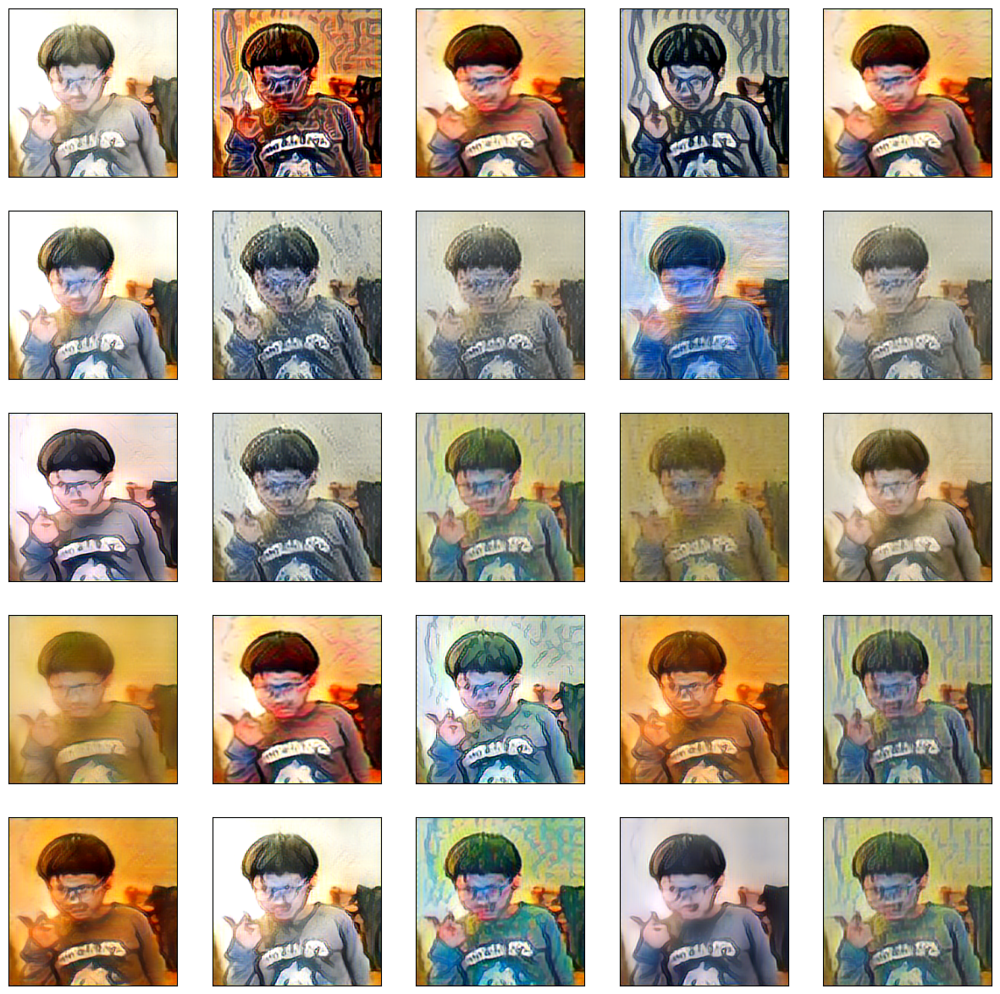

In [224]:
ds = roger_example()
outputs = []

for idx, (c_batch, s_batch) in enumerate(ds):
    if idx > 4:
        break
    output, c_enc_c, normalized_c, out_enc_c = model((c_batch, s_batch))
    outputs.append(output)

plot_outputs((outputs))

In [231]:
import os
import numpy as np
import matplotlib.pyplot as plt
import shutil
from google.colab import files

# Create output folder
output_folder = 'Output_images'
os.makedirs(output_folder, exist_ok=True)

# Assuming outputs is a list containing the output images
# Here outputs should be a list with one array containing 25 images
output_batch = np.concatenate(outputs, axis=0)  # Combine outputs from all batches

# Iterate over each output image and save
for idx in range(output_batch.shape[0]):  # output_batch.shape[0] is the number of images
    filename = f'{output_folder}/Output_{idx}.jpg'  # Generate a unique filename for each image
    plt.imsave(filename, np.clip(output_batch[idx, ...], 0, 1))  # Save each image

print(f'Images saved to {output_folder} folder.')

# Zip the output folder
shutil.make_archive(output_folder, 'zip', output_folder)

# Download the zip file
files.download(f'{output_folder}.zip')


Images saved to Output_images folder.


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>